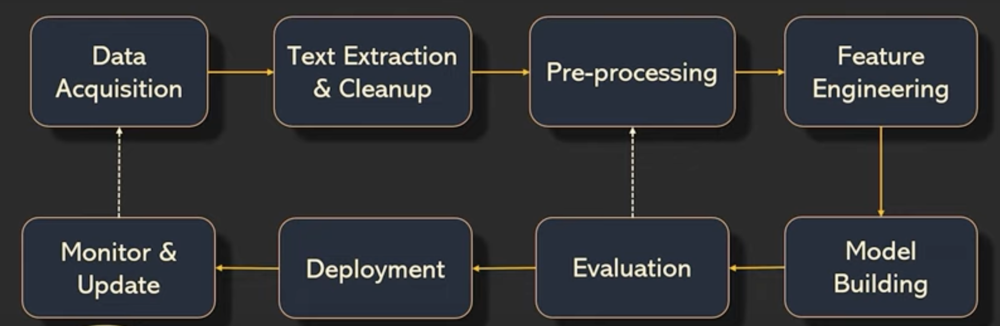

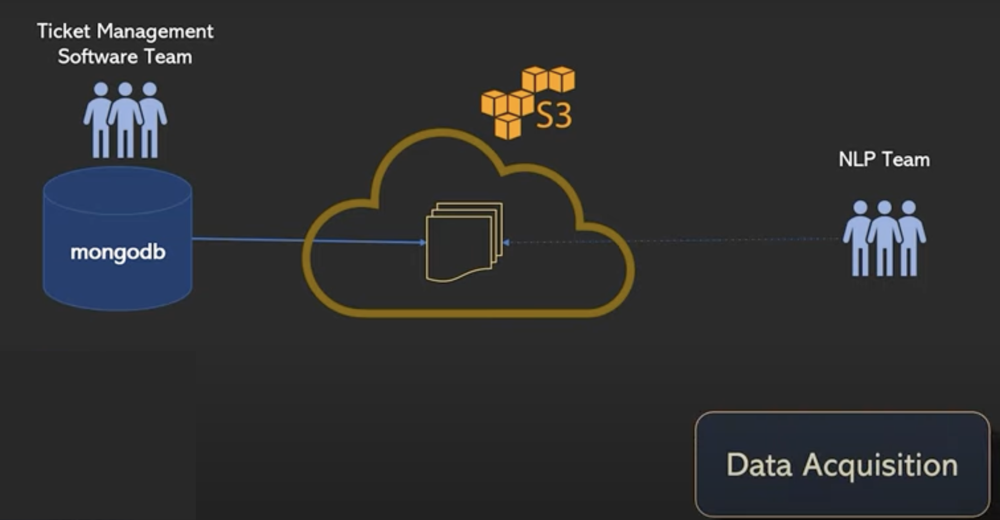

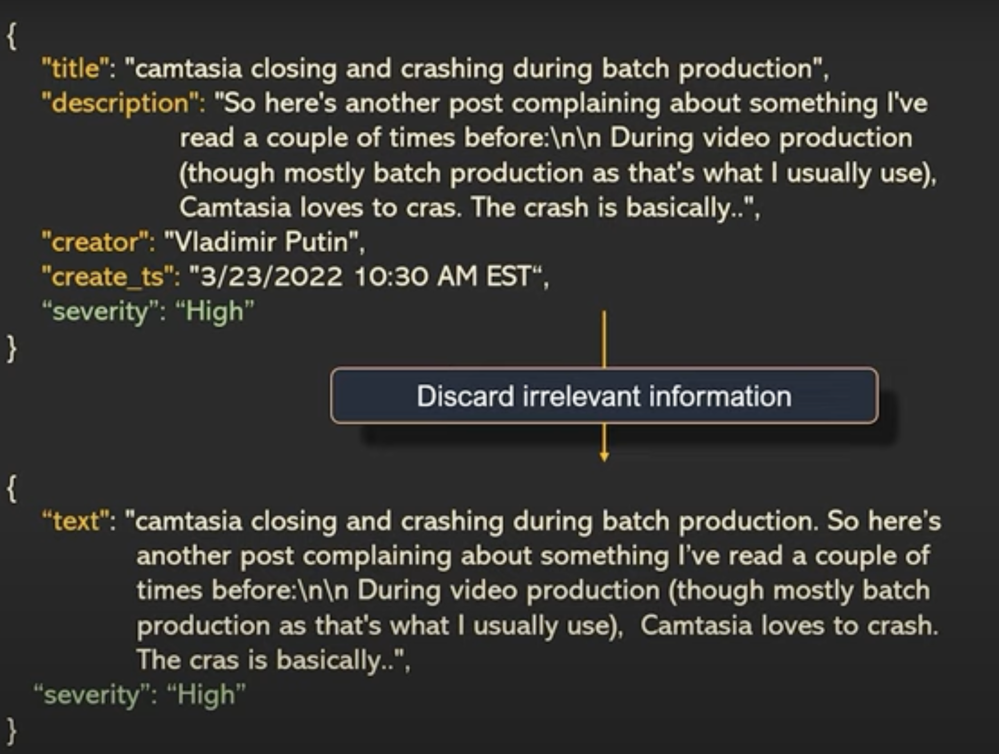

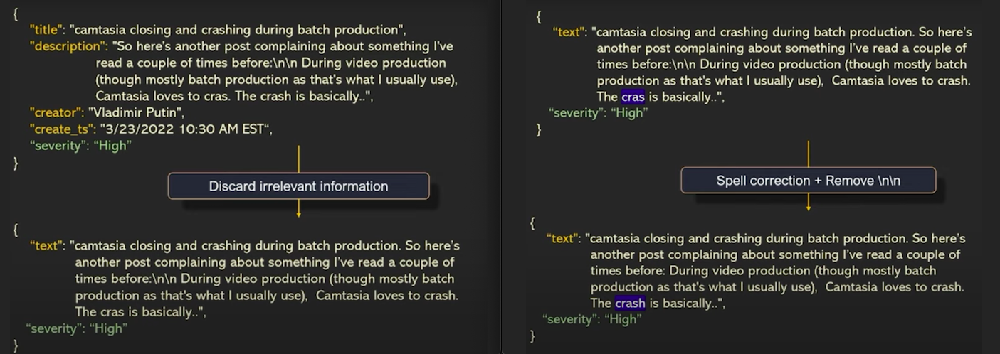

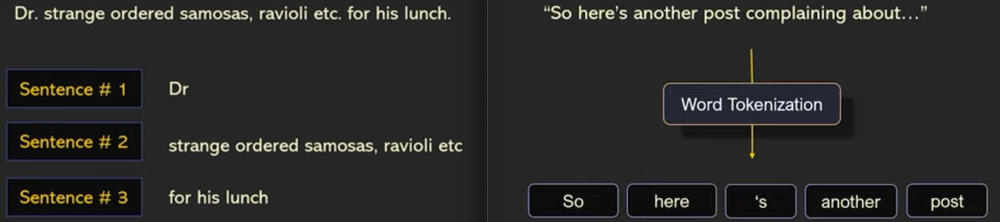

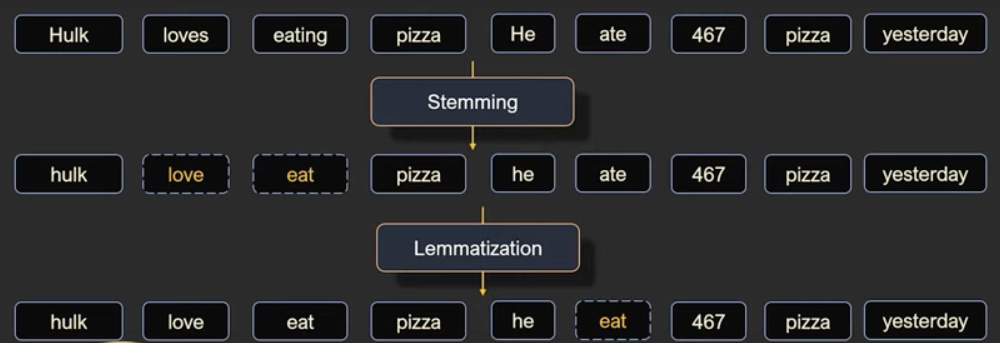

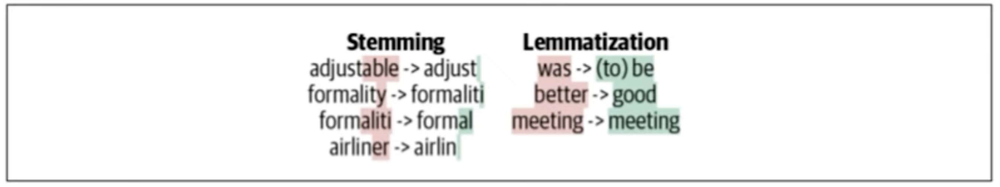

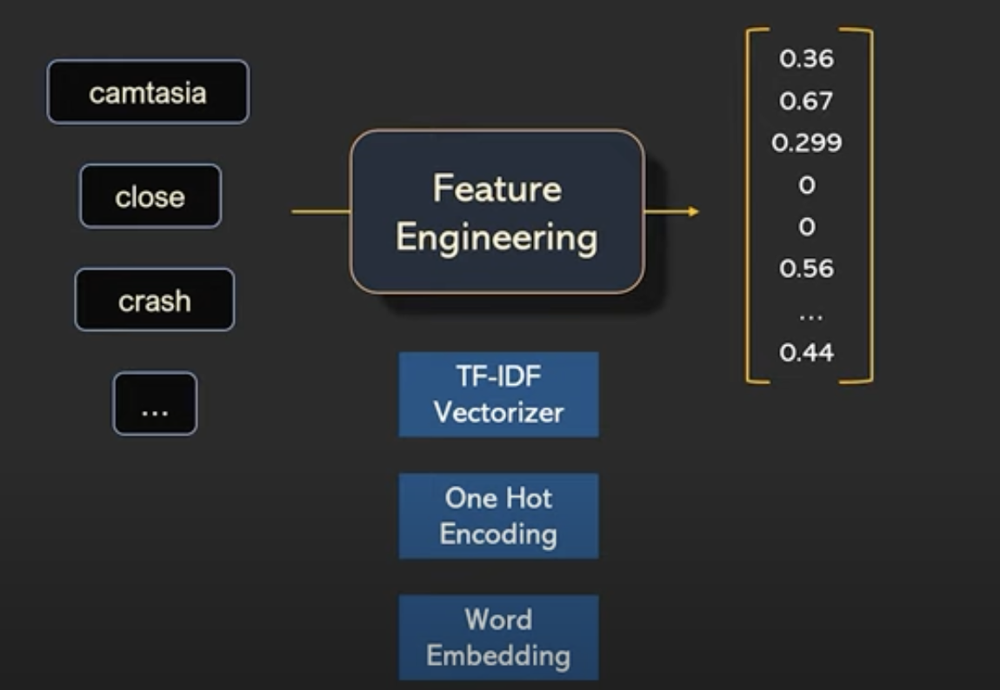

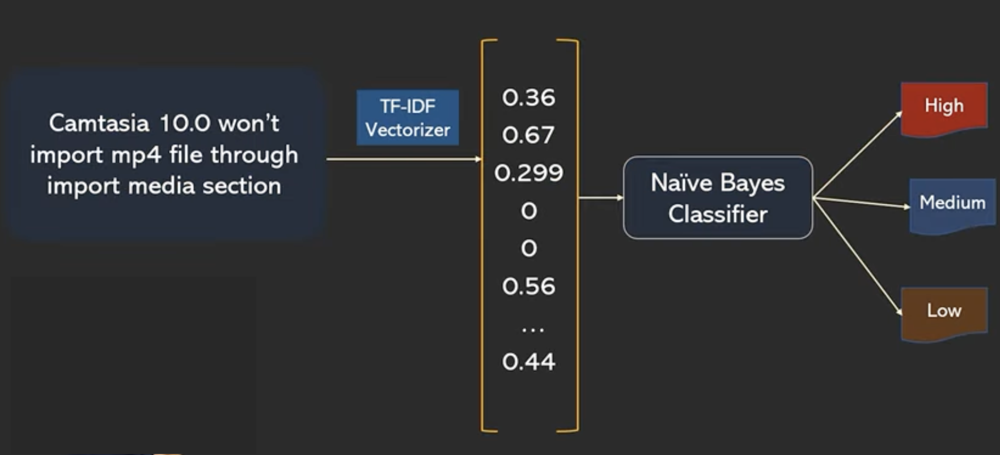

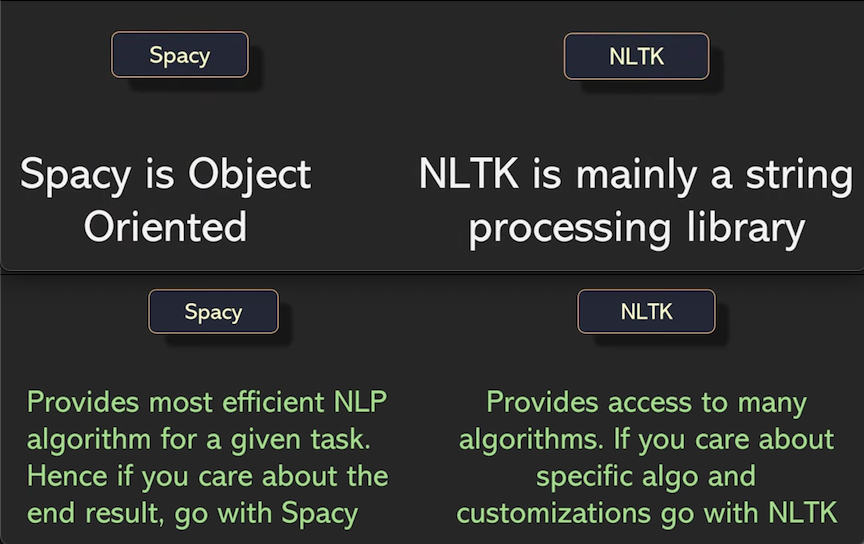

In [8]:
import spacy # This works as object oriented

In [4]:
nlp = spacy.load("en_core_web_sm")
doc = nlp('Dr.Strange loves kottu. Hulk loves sea foods')

In [5]:
for sentence in doc.sents:
    print(sentence)

Dr.Strange loves kottu.
Hulk loves sea foods


In [7]:
# for sentence in doc.sents:
#     for word in sentence:
#         print(word)

In [13]:
import nltk
# nltk.download('punkt')

showing info https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/index.xml


True

In [12]:
from nltk.tokenize import sent_tokenize
sent_tokenize("Dr.Strange loves kottu. Hulk loves sea foods")

['Dr.Strange loves kottu.', 'Hulk loves sea foods']

In [14]:
from nltk.tokenize import word_tokenize
word_tokenize("Dr.Strange loves kottu. Hulk loves sea foods")

['Dr.Strange', 'loves', 'kottu', '.', 'Hulk', 'loves', 'sea', 'foods']

In [15]:
nlp = spacy.blank('en')  # Use english as the language
doc = nlp('Iron man loves crispy chicken and it costs only 1$ per piece')

In [20]:
# for token in doc:
#     print(token)
doc[10]

$

In [24]:
span = doc[1:3]
type(span)

spacy.tokens.span.Span

In [21]:
type(nlp)

spacy.lang.en.English

In [26]:
type(doc[0])

spacy.tokens.token.Token

In [25]:
dir(doc[0])

['_',
 '__bytes__',
 '__class__',
 '__delattr__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__ne__',
 '__new__',
 '__pyx_vtable__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__unicode__',
 'ancestors',
 'check_flag',
 'children',
 'cluster',
 'conjuncts',
 'dep',
 'dep_',
 'doc',
 'ent_id',
 'ent_id_',
 'ent_iob',
 'ent_iob_',
 'ent_kb_id',
 'ent_kb_id_',
 'ent_type',
 'ent_type_',
 'get_extension',
 'has_dep',
 'has_extension',
 'has_head',
 'has_morph',
 'has_vector',
 'head',
 'i',
 'idx',
 'iob_strings',
 'is_alpha',
 'is_ancestor',
 'is_ascii',
 'is_bracket',
 'is_currency',
 'is_digit',
 'is_left_punct',
 'is_lower',
 'is_oov',
 'is_punct',
 'is_quote',
 'is_right_punct',
 'is_sent_end',
 'is_sent_start',
 'is_space',
 'is_stop',
 'is_title',
 'is_upper',
 'lang',
 'lang_',
 'le

In [28]:
token0 = doc[0]

In [29]:
token0.is_alpha

True

In [30]:
token0.like_num

False

 <h4 style='color:green;font-size:20px'> Grab all the emails from a text file <h4>

In [31]:
with open('data/students.txt') as f:
    text = f.readlines()
text

['Dayton high school, 8th grade students information\n',
 '==================================================\n',
 '\n',
 'Name\tbirth day   \temail\n',
 '-----\t------------\t------\n',
 'Virat   5 June, 1882    virat@kohli.com\n',
 'Maria\t12 April, 2001  maria@sharapova.com\n',
 'Serena  24 June, 1998   serena@williams.com \n',
 'Joe      1 May, 1997    joe@root.com\n',
 '\n',
 '\n',
 '\n']

In [32]:
text = ' '.join(text)
text

'Dayton high school, 8th grade students information\n ==================================================\n \n Name\tbirth day   \temail\n -----\t------------\t------\n Virat   5 June, 1882    virat@kohli.com\n Maria\t12 April, 2001  maria@sharapova.com\n Serena  24 June, 1998   serena@williams.com \n Joe      1 May, 1997    joe@root.com\n \n \n \n'

In [33]:
doc = nlp(text)
emails = []
for token in doc:
    if token.like_email:
        emails.append(token)
    
emails

[virat@kohli.com, maria@sharapova.com, serena@williams.com, joe@root.com]

In [37]:
nlp = spacy.blank('si')
doc = nlp('කෝ මගේ රුපියල් 5000')
for token in doc:
    print(token, 'Is currency:', token.is_currency,', Is number:',token.like_num )

කෝ Is currency: False , Is number: False
මගේ Is currency: False , Is number: False
රුපියල් Is currency: False , Is number: False
5000 Is currency: False , Is number: True


 <h4 style='color:green;font-size:20px'> Customize spacy tokens <h4>

In [38]:
doc = nlp('gimme chicken full rice')
tokens = [token.text for token in doc]
tokens

['gimme', 'chicken', 'full', 'rice']

In [40]:
from spacy.symbols import ORTH

nlp.tokenizer.add_special_case('gimme',[
    {ORTH:'gim'},
    {ORTH:'me'}
])

In [41]:
doc = nlp('gimme chicken full rice')
tokens = [token.text for token in doc]
tokens

['gim', 'me', 'chicken', 'full', 'rice']

 <h4 style='color:green;font-size:20px'> Create NLP Pipeline <h4>

In [55]:
nlp = spacy.blank('en')
doc = nlp("Dr.Strange loves kottu. Hulk loves sea foods")
for sentence in doc.sents:
    print(sentence)

ValueError: [E030] Sentence boundaries unset. You can add the 'sentencizer' component to the pipeline with: `nlp.add_pipe('sentencizer')`. Alternatively, add the dependency parser or sentence recognizer, or set sentence boundaries by setting `doc[i].is_sent_start`.

In [56]:
nlp.add_pipe('sentencizer')

In [57]:
nlp.pipe_names

['sentencizer']

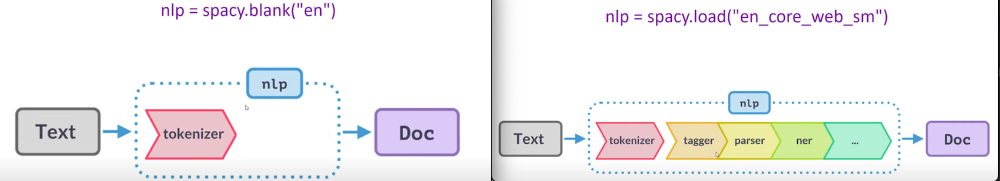

In [58]:
doc = nlp("Dr.Strange loves kottu. Hulk loves sea foods")
for sentence in doc.sents:
    print(sentence)

Dr.Strange loves kottu.
Hulk loves sea foods


In [59]:
import spacy
nlp = spacy.blank('en')
doc = nlp("Dr.Strange loves kottu. Hulk loves sea foods")

In [60]:
for token in doc:
    print(token)

Dr.
Strange
loves
kottu
.
Hulk
loves
sea
foods


In [61]:
nlp.pipe_names

[]

In [65]:
nlp_en_sm = spacy.load('en_core_web_sm')
nlp_en_sm.pipeline

[('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec at 0x2d7536d00>),
 ('tagger', <spacy.pipeline.tagger.Tagger at 0x2d7536c40>),
 ('parser', <spacy.pipeline.dep_parser.DependencyParser at 0x2d673f660>),
 ('attribute_ruler',
  <spacy.pipeline.attributeruler.AttributeRuler at 0x2d757ab80>),
 ('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer at 0x2d7575040>),
 ('ner', <spacy.pipeline.ner.EntityRecognizer at 0x2d673ff90>)]

In [64]:
doc_en_sm = nlp_en_sm("Dr.Strange loves kottu. Hulk loves sea foods")

for token in doc_en_sm:
    # token, proper noun, base word
    print(token, ' | ', token.pos_, ' | ', token.lemma_)

Dr.  |  PROPN  |  Dr.
Strange  |  PROPN  |  Strange
loves  |  VERB  |  love
kottu  |  NOUN  |  kottu
.  |  PUNCT  |  .
Hulk  |  PROPN  |  Hulk
loves  |  VERB  |  love
sea  |  NOUN  |  sea
foods  |  NOUN  |  food


In [67]:
doc_en_sm = nlp_en_sm("Tesla Inc is going to acquire twitter for $45 billion")

for ent in doc_en_sm.ents:
    print(ent.text, ' | ', ent.label_, ' | ', spacy.explain(ent.label_))

Tesla Inc  |  ORG  |  Companies, agencies, institutions, etc.
$45 billion  |  MONEY  |  Monetary values, including unit


In [69]:
from spacy import displacy
displacy.render(doc_en_sm, style='ent')

 <h4 style='color:green;font-size:20px'> Add componenets to pipeline <h4>

In [70]:
# Add components from other pipelines
source = spacy.load('en_core_web_sm')
nlp = spacy.blank('en')
nlp.add_pipe('ner', source=source)
nlp.pipe_names

['ner']

 <h4 style='color:green;font-size:20px'> Stemming and Lemmatization <h4>

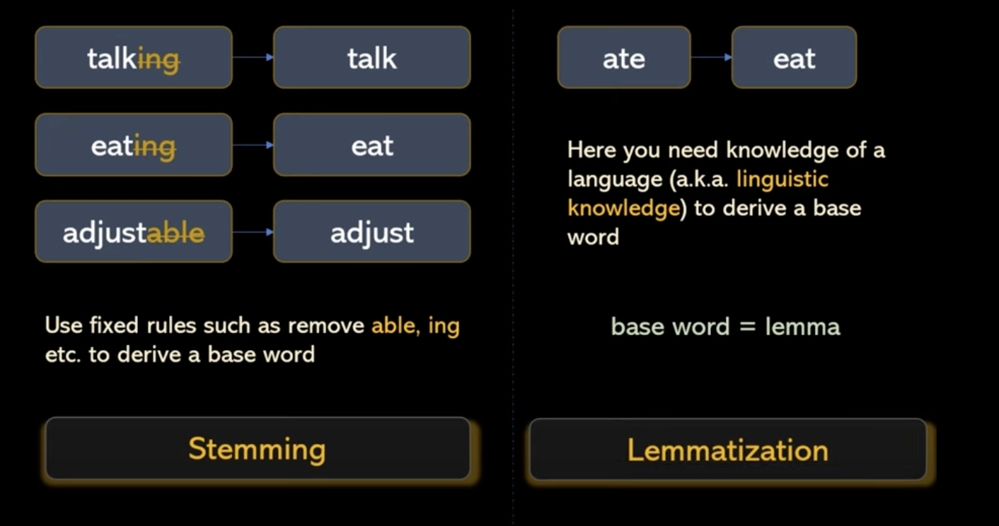

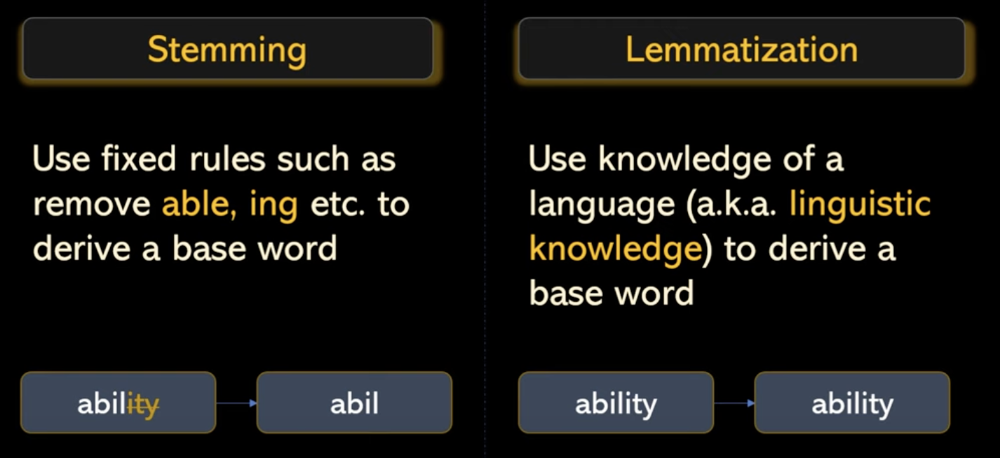

In [73]:
# Stemming -------------------------------------------------------------------------------------------------

In [71]:
from nltk.stem import PorterStemmer
stemmer = PorterStemmer()

In [72]:
words = ["eating", "eats", "eat", "ate", "adjustable", "rafting", "ability", "meeting"]

for word in words:
    print(word, "|", stemmer.stem(word))

eating | eat
eats | eat
eat | eat
ate | ate
adjustable | adjust
rafting | raft
ability | abil
meeting | meet


In [77]:
# lemmatize --------------------------------------------------------------------------------------------------

In [76]:
nlp = spacy.load('en_core_web_sm')
doc = nlp("eating eats eat ate adjustable rafting ability meeting better")
for token in doc:
    print(token, ' | ', token.lemma_)

eating  |  eat
eats  |  eat
eat  |  eat
ate  |  eat
adjustable  |  adjustable
rafting  |  raft
ability  |  ability
meeting  |  meeting
better  |  well


In [81]:
doc = nlp("Bro, you wanna go? Yo, don't say no! I am exhausted")
for token in doc:
    print(token.text, "|", token.lemma_)

Bro | bro
, | ,
you | you
wanna | wanna
go | go
? | ?
Yo | Yo
, | ,
do | do
n't | not
say | say
no | no
! | !
I | I
am | be
exhausted | exhaust


In [79]:
# Changing the rules -------------------------------------------------------------------------------------

In [80]:
nlp.pipe_names

['tok2vec', 'tagger', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']

In [84]:
ar = nlp.get_pipe('attribute_ruler')
ar.add([[{'TEXT':'Bro'}],[{'TEXT':'Yo'}]], {'LEMMA':'Brother'})

In [85]:
doc = nlp("Bro, you wanna go? Yo, don't say no! I am exhausted")
for token in doc:
    print(token.text, "|", token.lemma_)

Bro | Brother
, | ,
you | you
wanna | wanna
go | go
? | ?
Yo | Brother
, | ,
do | do
n't | not
say | say
no | no
! | !
I | I
am | be
exhausted | exhaust


 <h4 style='color:green;font-size:20px'> Part of Speech <h4>

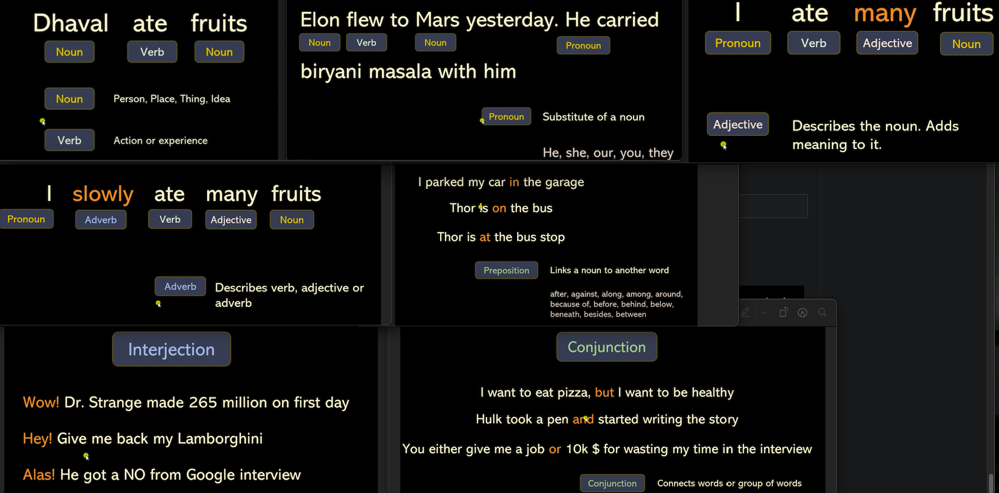

In [88]:
nlp = spacy.load('en_core_web_sm')
doc = nlp('Elon mask flew to mars yesterday. He carried his gun with him')

for token in doc:
    print(token, ' | ', token.pos_, ' | ', spacy.explain(token.pos_))

Elon  |  PROPN  |  proper noun
mask  |  NOUN  |  noun
flew  |  VERB  |  verb
to  |  ADP  |  adposition
mars  |  NOUN  |  noun
yesterday  |  NOUN  |  noun
.  |  PUNCT  |  punctuation
He  |  PRON  |  pronoun
carried  |  VERB  |  verb
his  |  PRON  |  pronoun
gun  |  NOUN  |  noun
with  |  ADP  |  adposition
him  |  PRON  |  pronoun


In [89]:
for token in doc:
    print(token, ' | ', token.pos_, ' | ', spacy.explain(token.pos_), ' | ', token.tag_, ' | ', spacy.explain(token.tag_))

Elon  |  PROPN  |  proper noun  |  NNP  |  noun, proper singular
mask  |  NOUN  |  noun  |  NN  |  noun, singular or mass
flew  |  VERB  |  verb  |  VBD  |  verb, past tense
to  |  ADP  |  adposition  |  IN  |  conjunction, subordinating or preposition
mars  |  NOUN  |  noun  |  NNS  |  noun, plural
yesterday  |  NOUN  |  noun  |  NN  |  noun, singular or mass
.  |  PUNCT  |  punctuation  |  .  |  punctuation mark, sentence closer
He  |  PRON  |  pronoun  |  PRP  |  pronoun, personal
carried  |  VERB  |  verb  |  VBD  |  verb, past tense
his  |  PRON  |  pronoun  |  PRP$  |  pronoun, possessive
gun  |  NOUN  |  noun  |  NN  |  noun, singular or mass
with  |  ADP  |  adposition  |  IN  |  conjunction, subordinating or preposition
him  |  PRON  |  pronoun  |  PRP  |  pronoun, personal


In [91]:
# Removing unwanted characters ------------------------------------------------------------------------

In [90]:
earnings_text="""Microsoft Corp. today announced the following results for the quarter ended December 31, 2021, as compared to the corresponding period of last fiscal year:

·         Revenue was $51.7 billion and increased 20%
·         Operating income was $22.2 billion and increased 24%
·         Net income was $18.8 billion and increased 21%
·         Diluted earnings per share was $2.48 and increased 22%
“Digital technology is the most malleable resource at the world’s disposal to overcome constraints and reimagine everyday work and life,” said Satya Nadella, chairman and chief executive officer of Microsoft. “As tech as a percentage of global GDP continues to increase, we are innovating and investing across diverse and growing markets, with a common underlying technology stack and an operating model that reinforces a common strategy, culture, and sense of purpose.”
“Solid commercial execution, represented by strong bookings growth driven by long-term Azure commitments, increased Microsoft Cloud revenue to $22.1 billion, up 32% year over year” said Amy Hood, executive vice president and chief financial officer of Microsoft."""

doc = nlp(earnings_text)
for token in doc:
    print(token, ' | ', token.pos_, ' | ', spacy.explain(token.pos_))

Microsoft  |  PROPN  |  proper noun
Corp.  |  PROPN  |  proper noun
today  |  NOUN  |  noun
announced  |  VERB  |  verb
the  |  DET  |  determiner
following  |  VERB  |  verb
results  |  NOUN  |  noun
for  |  ADP  |  adposition
the  |  DET  |  determiner
quarter  |  NOUN  |  noun
ended  |  VERB  |  verb
December  |  PROPN  |  proper noun
31  |  NUM  |  numeral
,  |  PUNCT  |  punctuation
2021  |  NUM  |  numeral
,  |  PUNCT  |  punctuation
as  |  SCONJ  |  subordinating conjunction
compared  |  VERB  |  verb
to  |  ADP  |  adposition
the  |  DET  |  determiner
corresponding  |  ADJ  |  adjective
period  |  NOUN  |  noun
of  |  ADP  |  adposition
last  |  ADJ  |  adjective
fiscal  |  ADJ  |  adjective
year  |  NOUN  |  noun
:  |  PUNCT  |  punctuation


  |  SPACE  |  space
·  |  PUNCT  |  punctuation
          |  SPACE  |  space
Revenue  |  NOUN  |  noun
was  |  AUX  |  auxiliary
$  |  SYM  |  symbol
51.7  |  NUM  |  numeral
billion  |  NUM  |  numeral
and  |  CCONJ  |  coordinating co

In [92]:
filtered_tokens = []

for token in doc:
    if token.pos_ not in ['SPACE','PUNCT','X']:
        filtered_tokens.append(token)
        
filtered_tokens

[Microsoft,
 Corp.,
 today,
 announced,
 the,
 following,
 results,
 for,
 the,
 quarter,
 ended,
 December,
 31,
 2021,
 as,
 compared,
 to,
 the,
 corresponding,
 period,
 of,
 last,
 fiscal,
 year,
 Revenue,
 was,
 $,
 51.7,
 billion,
 and,
 increased,
 20,
 %,
 Operating,
 income,
 was,
 $,
 22.2,
 billion,
 and,
 increased,
 24,
 %,
 Net,
 income,
 was,
 $,
 18.8,
 billion,
 and,
 increased,
 21,
 %,
 Diluted,
 earnings,
 per,
 share,
 was,
 $,
 2.48,
 and,
 increased,
 22,
 %,
 Digital,
 technology,
 is,
 the,
 most,
 malleable,
 resource,
 at,
 the,
 world,
 ’s,
 disposal,
 to,
 overcome,
 constraints,
 and,
 reimagine,
 everyday,
 work,
 and,
 life,
 said,
 Satya,
 Nadella,
 chairman,
 and,
 chief,
 executive,
 officer,
 of,
 Microsoft,
 As,
 tech,
 as,
 a,
 percentage,
 of,
 global,
 GDP,
 continues,
 to,
 increase,
 we,
 are,
 innovating,
 and,
 investing,
 across,
 diverse,
 and,
 growing,
 markets,
 with,
 a,
 common,
 underlying,
 technology,
 stack,
 and,
 an,
 operating,

In [95]:
counts = doc.count_by(spacy.attrs.POS)
counts

{96: 13,
 92: 46,
 100: 24,
 90: 9,
 85: 16,
 93: 16,
 97: 27,
 98: 1,
 84: 20,
 103: 10,
 87: 6,
 99: 5,
 89: 12,
 86: 3,
 94: 3,
 95: 2}

In [97]:
doc.vocab[96].text

'PROPN'

In [100]:
for k,v in counts.items():
    print(doc.vocab[k].text,':',v)

PROPN : 13
NOUN : 46
VERB : 24
DET : 9
ADP : 16
NUM : 16
PUNCT : 27
SCONJ : 1
ADJ : 20
SPACE : 10
AUX : 6
SYM : 5
CCONJ : 12
ADV : 3
PART : 3
PRON : 2


 <h4 style='color:green;font-size:20px'> Named entity recognition <h4>

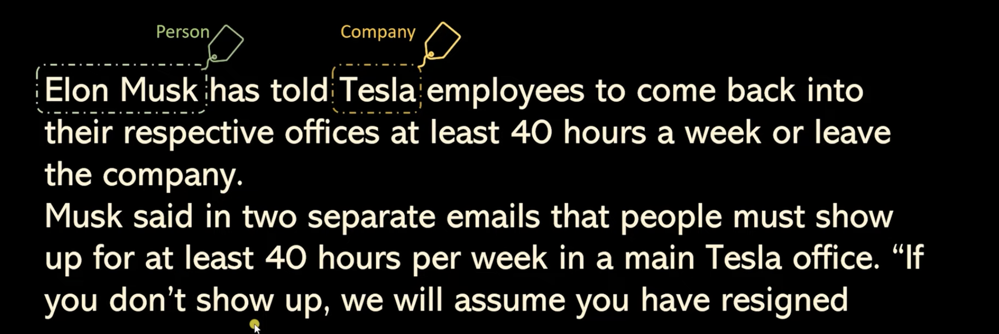

In [101]:
nlp = spacy.load('en_core_web_sm')
nlp.pipe_names

['tok2vec', 'tagger', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']

In [107]:
doc = nlp("Tesla Inc is going to acquire Twitter for $45 billion")

for entity in doc.ents:
    print(entity.text, ' | ', entity.label_, ' | ', spacy.explain(entity.label_))

Tesla Inc  |  ORG  |  Companies, agencies, institutions, etc.
Twitter  |  PRODUCT  |  Objects, vehicles, foods, etc. (not services)
$45 billion  |  MONEY  |  Monetary values, including unit


In [108]:
from spacy import displacy
displacy.render(doc, style='ent')

In [109]:
nlp.pipe_labels['ner']

['CARDINAL',
 'DATE',
 'EVENT',
 'FAC',
 'GPE',
 'LANGUAGE',
 'LAW',
 'LOC',
 'MONEY',
 'NORP',
 'ORDINAL',
 'ORG',
 'PERCENT',
 'PERSON',
 'PRODUCT',
 'QUANTITY',
 'TIME',
 'WORK_OF_ART']

In [115]:
doc = nlp("Tesla is going to acquire twitter and tiktok for $45 billion")
for entity in doc.ents:
    print(entity.text, ' | ', entity.label_, ' | ', spacy.explain(entity.label_))

Tesla  |  ORG  |  Companies, agencies, institutions, etc.
$45 billion  |  MONEY  |  Monetary values, including unit


In [116]:
type(doc[0])

spacy.tokens.token.Token

In [117]:
type(doc[2:4]) # Normally its like aray but we use as span in nlp

spacy.tokens.span.Span

In [118]:
from spacy.tokens import Span
s1 = Span(doc, 5,6, label='ORG')
s2 = Span(doc, 7,8, label='ORG')
doc.set_ents([s1,s2], default='unmodified')

In [119]:
for entity in doc.ents:
    print(entity.text, ' | ', entity.label_, ' | ', spacy.explain(entity.label_))

Tesla  |  ORG  |  Companies, agencies, institutions, etc.
twitter  |  ORG  |  Companies, agencies, institutions, etc.
tiktok  |  ORG  |  Companies, agencies, institutions, etc.
$45 billion  |  MONEY  |  Monetary values, including unit


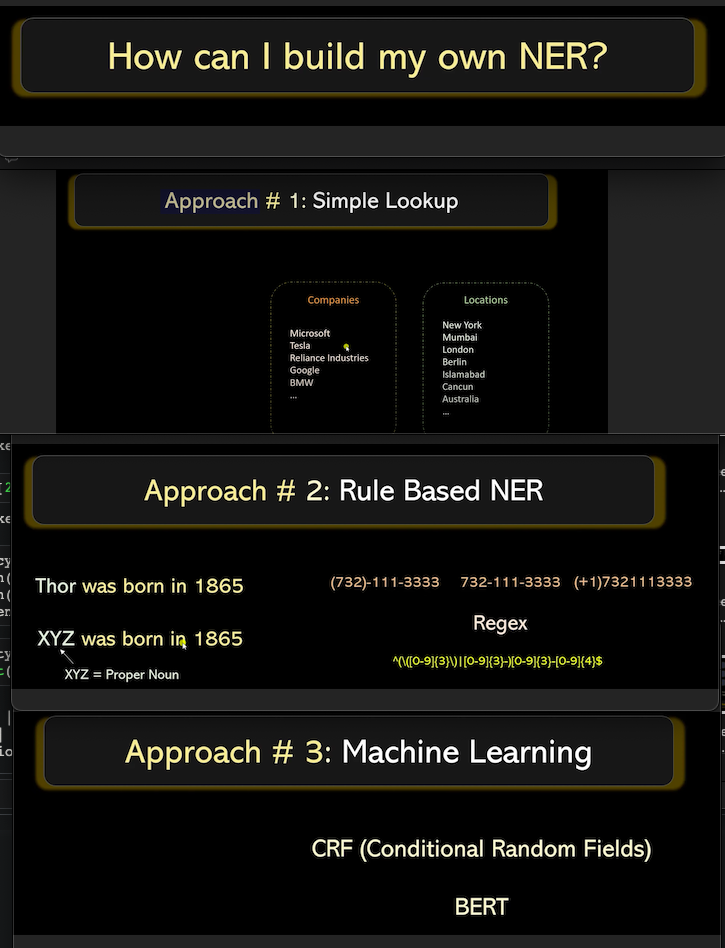

 <h4 style='color:Red;font-size:40px'> Feature Engineering  🤨 <h4>

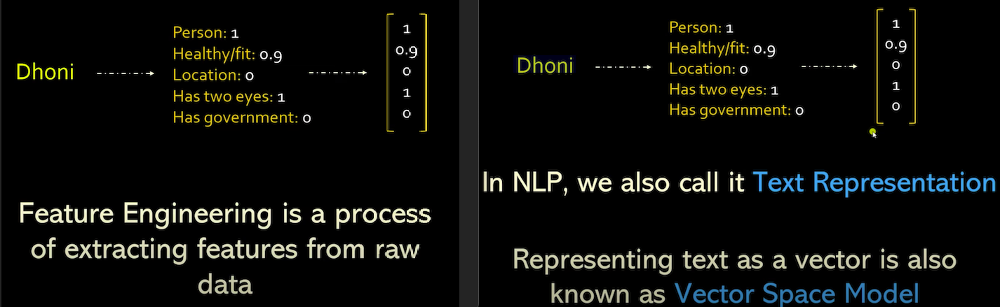

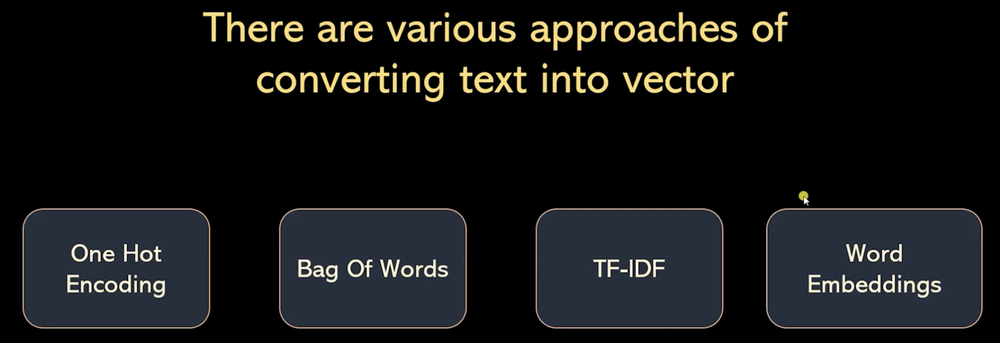

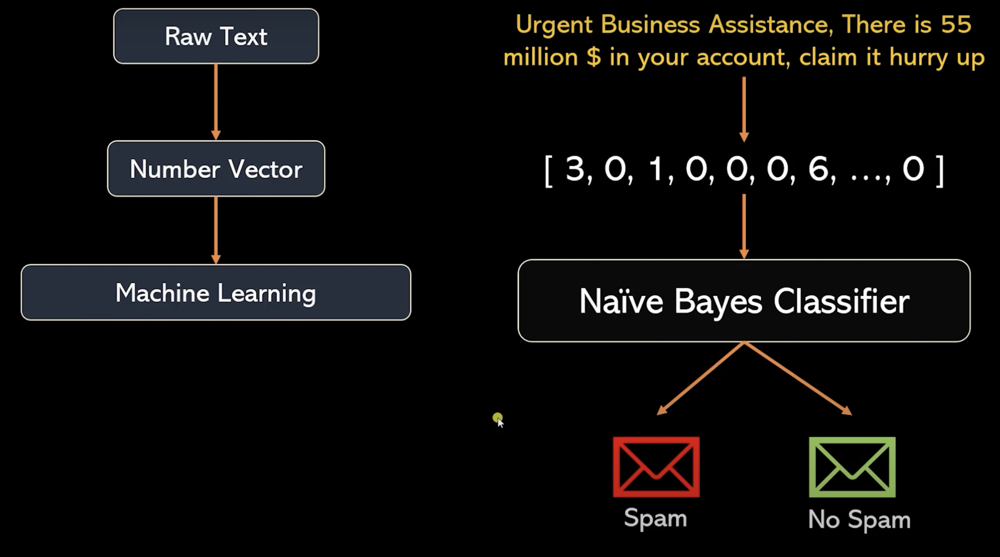

 <h4 style='color:green;font-size:20px'> Raw text to number vector <h4>

In [120]:
# Approach 1 - label encoding ------------------------------------------------------------------------------

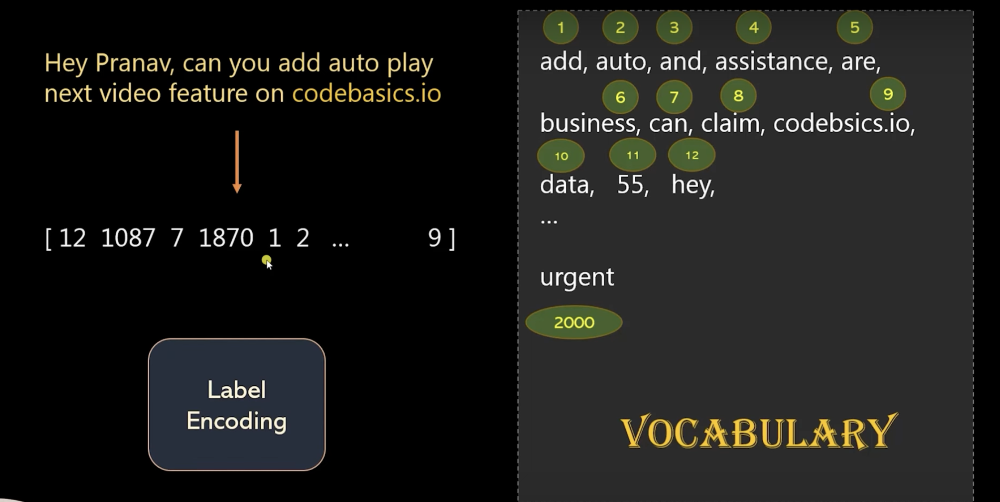

In [122]:
# Approach 2 - One hot encoding ------------------------------------------------------------------------------

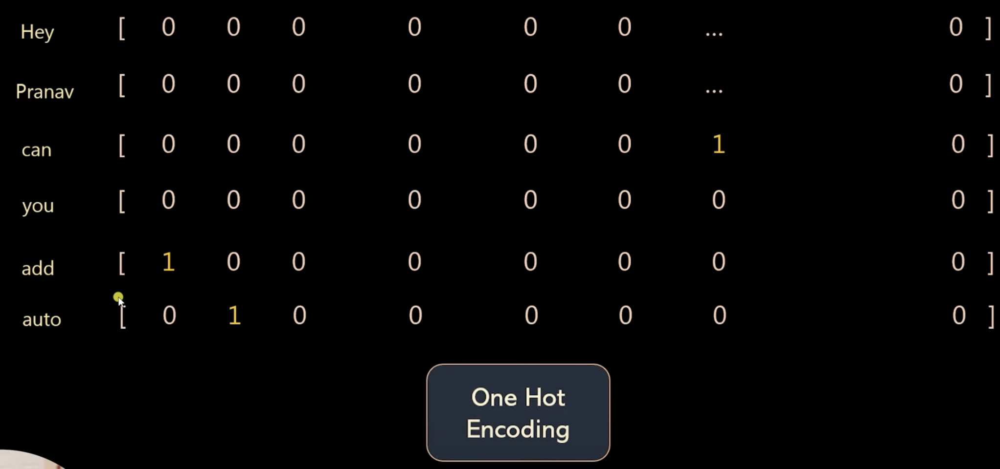

#### Disadvantages -----------  ☹️<br>
1. Similer words do not have similer representations <br>
2. Consume too much memory and compute resources <br>
3. Out of vocobulary if new words are appeared <br>
4. Input layer have to different when the text has different count of words , not possible

In [123]:
# Approach 3 - Bag of words ------------------------------------------------------------------------------

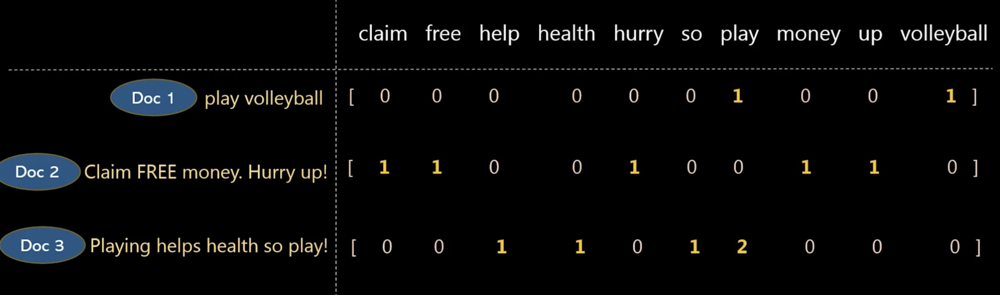

In [124]:
# In here it is same as one hot encoding but less words becasue we use stemming and lemmatizing

In [125]:
# from sklearn.feature_extraction.text import CountVectorizer
# cv = CountVectorizer()
# x_train_cv = cv.fit_transform(x_train.values)

In [126]:
# from sklearn.pipeline import Pipeline

# clf = Pipeline([
#     ('Vectorizer', CountVectorizer()),
#     ('nb', MultinomialNB())
# ])

# clf.fit(x_train,y_train)

In [163]:
# Approach 4 - Bag of words with N-Grams ------------------------------------------------------------------------

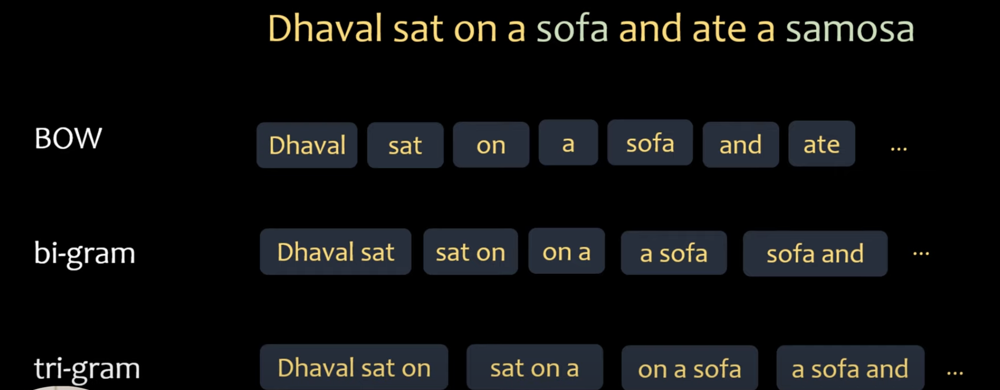

In [164]:
# Using 1-gram and bi-gram

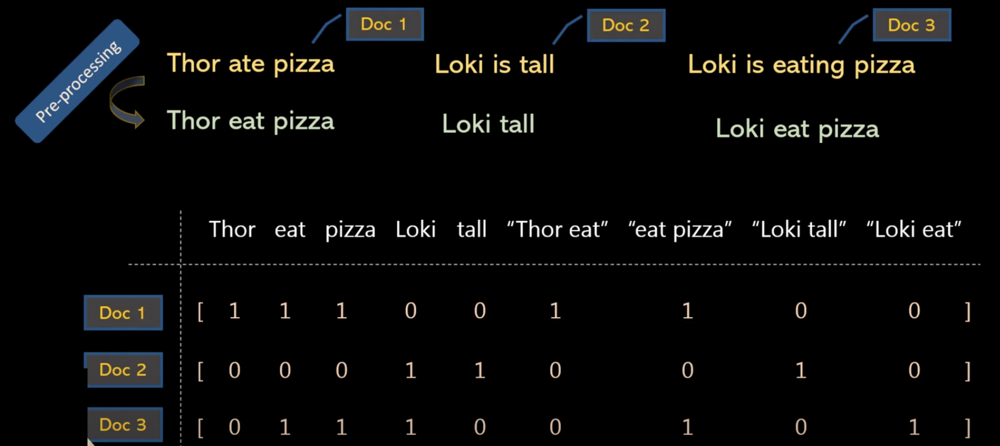

In [167]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(ngram_range=(2,2))
cv.fit(['Thor is looking for a hammer'])
cv.vocabulary_

{'thor is': 3, 'is looking': 1, 'looking for': 2, 'for hammer': 0}

In [168]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(ngram_range=(1,2))
cv.fit(['Thor is looking for a hammer'])
cv.vocabulary_

{'thor': 7,
 'is': 3,
 'looking': 5,
 'for': 0,
 'hammer': 2,
 'thor is': 8,
 'is looking': 4,
 'looking for': 6,
 'for hammer': 1}

In [169]:
corpus = [
    "Thor ate pizza",
    "Loki is tall",
    "Loki is eating pizza"
]

In [170]:
import spacy
nlp = spacy.load('en_core_web_sm')

In [172]:
def preprocess(text):
    doc = nlp(text)
    filtered_tokens = []
    for token in doc:
        if not token.is_stop or token.is_punct:
            filtered_tokens.append(token.lemma_)
    return ' '.join(filtered_tokens)

In [173]:
preprocess(corpus[0])

'thor eat pizza'

In [174]:
corpus_process = [preprocess(x) for x in corpus]

In [176]:
corpus_process[1]

'Loki tall'

In [178]:
cv = CountVectorizer(ngram_range=(1,2))

In [179]:
cv.fit(corpus_process)

CountVectorizer(ngram_range=(1, 2))

In [180]:
cv.vocabulary_

{'thor': 7,
 'eat': 0,
 'pizza': 5,
 'thor eat': 8,
 'eat pizza': 1,
 'loki': 2,
 'tall': 6,
 'loki tall': 4,
 'loki eat': 3}

In [182]:
cv.transform(['Thor eat pizza']).toarray()

array([[1, 1, 0, 0, 0, 1, 0, 1, 1]])

In [127]:
# Approach 5 - Stop words ------------------------------------------------------------------------------

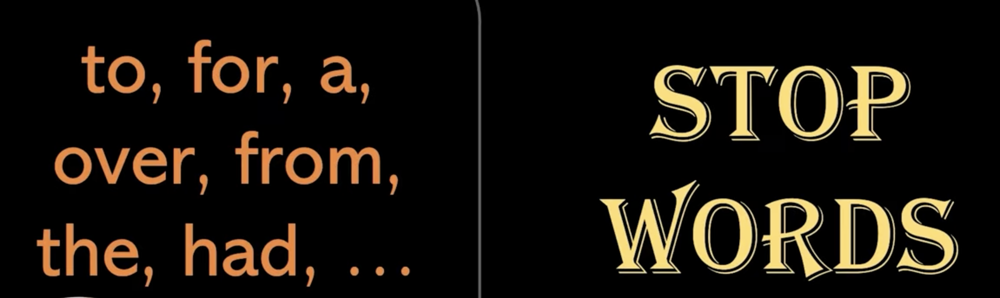

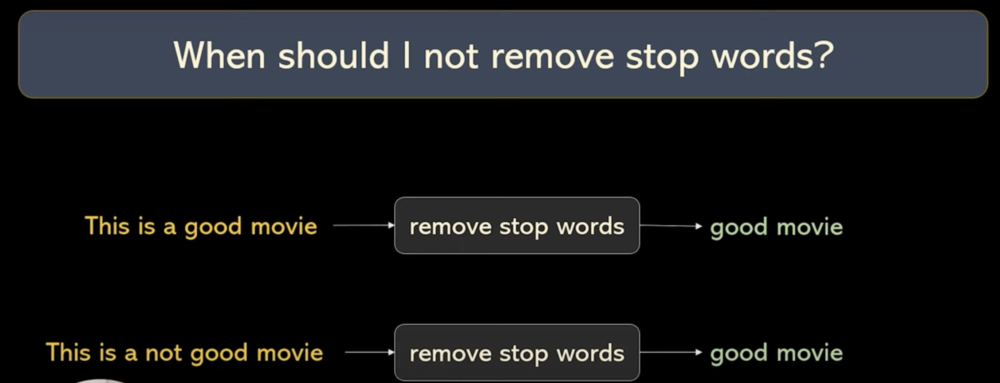

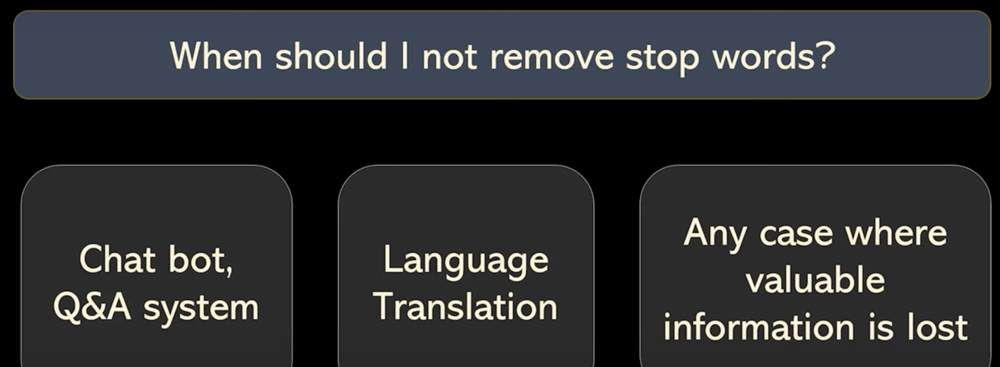

In [130]:
# We can use to find what about the article is - Iphone, Tesla etc.

In [128]:
import spacy
from spacy.lang.en.stop_words import STOP_WORDS
STOP_WORDS

{"'d",
 "'ll",
 "'m",
 "'re",
 "'s",
 "'ve",
 'a',
 'about',
 'above',
 'across',
 'after',
 'afterwards',
 'again',
 'against',
 'all',
 'almost',
 'alone',
 'along',
 'already',
 'also',
 'although',
 'always',
 'am',
 'among',
 'amongst',
 'amount',
 'an',
 'and',
 'another',
 'any',
 'anyhow',
 'anyone',
 'anything',
 'anyway',
 'anywhere',
 'are',
 'around',
 'as',
 'at',
 'back',
 'be',
 'became',
 'because',
 'become',
 'becomes',
 'becoming',
 'been',
 'before',
 'beforehand',
 'behind',
 'being',
 'below',
 'beside',
 'besides',
 'between',
 'beyond',
 'both',
 'bottom',
 'but',
 'by',
 'ca',
 'call',
 'can',
 'cannot',
 'could',
 'did',
 'do',
 'does',
 'doing',
 'done',
 'down',
 'due',
 'during',
 'each',
 'eight',
 'either',
 'eleven',
 'else',
 'elsewhere',
 'empty',
 'enough',
 'even',
 'ever',
 'every',
 'everyone',
 'everything',
 'everywhere',
 'except',
 'few',
 'fifteen',
 'fifty',
 'first',
 'five',
 'for',
 'former',
 'formerly',
 'forty',
 'four',
 'from',
 'fron

In [129]:
nlp = spacy.load('en_core_web_sm')
doc = nlp('We just opened our wings, flying part is coming soon')

for token in doc:
    if token.is_stop:
        print(token)

We
just
our
part
is


In [156]:
def preprocess(text):
    doc = nlp(text)
    no_stop_words = [token.text for token in doc if not token.is_stop and not token.is_punct]
    # I need the return as string
    return ' '.join(no_stop_words)

In [157]:
preprocess('We just opened our wings, flying part is coming soon')

'opened wings flying coming soon'

In [137]:
import pandas as pd
df = pd.read_json('./data/doj_press.json', lines=True)
df.head()

,id,title,contents,date,topics,components
0,None,Convicted Bomb Plotter Sentenced to 30 Years,"PORTLAND, Oregon. – Mohamed Osman Mohamud, 23,...",2014-10-01T00:00:00-04:00,[],[National Security Division (NSD)]
1,12-919,$1 Million in Restitution Payments Announced t...,WASHINGTON – North Carolina’s Waccamaw River...,2012-07-25T00:00:00-04:00,[],[Environment and Natural Resources Division]
2,11-1002,$1 Million Settlement Reached for Natural Reso...,BOSTON– A $1-million settlement has been...,2011-08-03T00:00:00-04:00,[],[Environment and Natural Resources Division]
3,10-015,10 Las Vegas Men Indicted \r\nfor Falsifying V...,WASHINGTON—A federal grand jury in Las Vegas...,2010-01-08T00:00:00-05:00,[],[Environment and Natural Resources Division]
4,18-898,$100 Million Settlement Will Speed Cleanup Wor...,"The U.S. Department of Justice, the U.S. Envir...",2018-07-09T00:00:00-04:00,[Environment],[Environment and Natural Resources Division]


In [138]:
df.shape

(13087, 6)

In [140]:
type(df.topics[4])

list

In [146]:
df = df[df.topics.str.len()!=0]
df.head()

,id,title,contents,date,topics,components
4,18-898,$100 Million Settlement Will Speed Cleanup Wor...,"The U.S. Department of Justice, the U.S. Envir...",2018-07-09T00:00:00-04:00,[Environment],[Environment and Natural Resources Division]
7,14-1412,14 Indicted in Connection with New England Com...,A 131-count criminal indictment was unsealed t...,2014-12-17T00:00:00-05:00,[Consumer Protection],[Civil Division]
19,17-1419,2017 Southeast Regional Animal Cruelty Prosecu...,The United States Attorney’s Office for the Mi...,2017-12-14T00:00:00-05:00,[Environment],"[Environment and Natural Resources Division, U..."
22,15-1562,21st Century Oncology to Pay $19.75 Million to...,"21st Century Oncology LLC, has agreed to pay $...",2015-12-18T00:00:00-05:00,"[False Claims Act, Health Care Fraud]",[Civil Division]
23,17-1404,21st Century Oncology to Pay $26 Million to Se...,21st Century Oncology Inc. and certain of its ...,2017-12-12T00:00:00-05:00,"[Health Care Fraud, False Claims Act]","[Civil Division, USAO - Florida, Middle]"


In [147]:
df.shape

(4688, 6)

In [149]:
df.contents[4]

"The U.S. Department of Justice, the U.S. Environmental Protection Agency (EPA), and the Rhode Island Department of Environmental Management (RIDEM) announced today that two subsidiaries of Stanley Black & Decker Inc.—Emhart Industries Inc. and Black & Decker Inc.—have agreed to clean up dioxin contaminated sediment and soil at the Centredale Manor Restoration Project Superfund Site in North Providence and Johnston, Rhode Island.\xa0 “We are pleased to reach a resolution through collaborative work with the responsible parties, EPA, and other stakeholders,” said\xa0Acting Assistant Attorney General Jeffrey H. Wood for the Justice Department's\xa0Environment and Natural Resources Division . “Today’s settlement ends protracted litigation and allows for important work to get underway to restore a healthy environment for citizens living in and around the Centredale Manor Site and the Woonasquatucket River.” “This settlement demonstrates the tremendous progress we are achieving working with 

In [158]:
df['content_new'] = df.contents.apply(preprocess)

In [159]:
df.head()

,id,title,contents,date,topics,components,content_new
4,18-898,$100 Million Settlement Will Speed Cleanup Wor...,"The U.S. Department of Justice, the U.S. Envir...",2018-07-09T00:00:00-04:00,[Environment],[Environment and Natural Resources Division],U.S. Department Justice U.S. Environmental Pro...
7,14-1412,14 Indicted in Connection with New England Com...,A 131-count criminal indictment was unsealed t...,2014-12-17T00:00:00-05:00,[Consumer Protection],[Civil Division],131 count criminal indictment unsealed today B...
19,17-1419,2017 Southeast Regional Animal Cruelty Prosecu...,The United States Attorney’s Office for the Mi...,2017-12-14T00:00:00-05:00,[Environment],"[Environment and Natural Resources Division, U...",United States Attorney Office Middle District ...
22,15-1562,21st Century Oncology to Pay $19.75 Million to...,"21st Century Oncology LLC, has agreed to pay $...",2015-12-18T00:00:00-05:00,"[False Claims Act, Health Care Fraud]",[Civil Division],21st Century Oncology LLC agreed pay $ 19.75 m...
23,17-1404,21st Century Oncology to Pay $26 Million to Se...,21st Century Oncology Inc. and certain of its ...,2017-12-12T00:00:00-05:00,"[Health Care Fraud, False Claims Act]","[Civil Division, USAO - Florida, Middle]",21st Century Oncology Inc. certain subsidiarie...


In [161]:
len(df.contents[4])

6286

In [162]:
len(df.content_new[4])

4574